In [1]:
using Pkg
using Plots, LaTeXStrings, Measures
Pkg.activate("/home/julisn/Codes/MFDecoupling.jl")
using MFDecoupling
using JLD2, DataFrames
using Statistics, FourierAnalysis

LoadError: ArgumentError: Package Plots not found in current path.
- Run `import Pkg; Pkg.add("Plots")` to install the Plots package.

In [2]:
fn_pt = "/home/julisn/Hamburg/Projects/MFDecoupling/data/out_pt1.jld2"
fn_coarse = "/home/julisn/Hamburg/Projects/MFDecoupling/data/out_coarse.jld2"
fn_smallU = "/home/julisn/Hamburg/Projects/MFDecoupling/data/out_smallU.jld2"
dfFile = "/home/julisn/Hamburg/Projects/MFDecoupling/data/U01V05_df.jld2"
Uin = 0.1
Vin = 0.5

0.5

In [3]:
function build_df(fn::String)
    df = DataFrame(U = Float64[], V = Float64[], t = Vector{Float64}[],        rho11 = Vector{ComplexF64}[], rho12 = Vector{ComplexF64}[],
                   rho13 = Vector{ComplexF64}[], rho14 = Vector{ComplexF64}[], rho22 = Vector{ComplexF64}[], rho23 = Vector{ComplexF64}[],
                   rho24 = Vector{ComplexF64}[], rho33= Vector{ComplexF64}[],  rho34 = Vector{ComplexF64}[], rho44 = Vector{ComplexF64}[], C01 = Vector{ComplexF64}[])
    if isfile(fn)
        rU, rV, rT, rS = jldopen(fn,"r") do ft
            ft["U"], ft["V"], ft["t"], ft["solution"]
        end
        for i in 1:length(rU)
            row = [rU[i], rV[i], rT, eachslice(rS[:,:,i],dims=1)...]
            push!(df,row)
        end
    elseif isdir(fn)
        fl = readdir(fn, join=true)
        filter!(x-> endswith(x,"jld2"), fl)
        for fi in fl
            rU, rV, rT, rS = jldopen(fi,"r") do fii
                tmp = keys(fii)[1]
                #V = haskey(fii["$tmp"], "V") ? fii["$tmp/V"] : NaN
                if haskey(fii, "U")
                    fii["U"], fii["V"], fii["t"], fii["sol"]
                else
                    fii["$tmp/U"], NaN, fii["$tmp/t"], fii["$tmp/sol"]
                end
            end
            row = [rU, rV, rT, eachslice(rS,dims=1)...]
            push!(df,row)
        end
    else
        error("$fn is not a result file or directory!")
    end
    df[!,:f_up] = df[:,:rho13] .+ df[:,:rho24]
    df[!,:f_do] = df[:,:rho12] .+ df[:,:rho34]
    
    # supplement mean value
    lim_ind = 10000
    var_window = trunc(Int, length(df[1,:t]) / 10)
    for cn in names(df)[4:end]
        df[!,Symbol(cn * "_lim")] = map(x-> mean(x[end-lim_ind:end]), df[:,Symbol(cn)])
        df[!,Symbol(cn * "_std")] = map(x-> [std(x[i-var_window:i]) for i in var_window+1:length(x)], df[:,Symbol(cn)])
    end
    
    # calculate ffts of time series
    fft_cols = ["rho11", "rho12", "rho22", "rho24", "f_up", "C01"]
    fft_start_i = length(df[1,:t])-trunc(Int, length(df[1,:t]) / 10)
    tx_fft = df[1,:t][fft_start_i:end]
    freqs = collect(FourierAnalysis.fftfreq(length(tx_fft), 1.0/diff(tx_fft)[1]) |> FourierAnalysis.fftshift)
    df[!,:freqs] = [freqs for i in 1:size(df,1)]
    for cl in fft_cols
        df[!,Symbol(cl * "_fft")] = map(x-> FourierAnalysis.fft(x[1][fft_start_i:end] .- x[2]) ./ length(x[1]) |> FourierAnalysis.fftshift, eachrow(df[:,[Symbol(cl),Symbol(cl * "_lim")]]))
        df[!,Symbol(cl * "_fft_zm")] = map(x-> FourierAnalysis.fft(x[fft_start_i:end]) ./ length(x[fft_start_i:end]) |> FourierAnalysis.fftshift, df[:,Symbol(cl)])
    end

    return df
end

df = if isfile(dfFile)
    jldopen(dfFile) do ff
        ff["df"]
    end
else
    df_pt = build_df(fn_pt);
    df_coarse = build_df(fn_coarse);
    df_smallU = build_df(fn_smallU);
    
    # combine and remove duplicates
    df = combine(groupby(vcat(df_pt,df_coarse, df_smallU), [:U, :V]), last); 
    jldopen(dfFile, "w") do ff
        ff["df"] = df
    end
end

df_Vin = df[df.V .≈ Vin, :]
sort!(df_Vin, [:U])

VList = sort(unique(df.V))

40-element Vector{Float64}:
  0.0
  0.2222222222222222
  0.3448275862068966
  0.4444444444444444
  0.5
  0.6666666666666666
  0.6896551724137931
  0.8888888888888888
  1.0344827586206897
  1.1111111111111112
  1.3333333333333333
  1.3793103448275863
  1.5555555555555556
  ⋮
  6.206896551724138
  6.551724137931034
  6.8965517241379315
  7.241379310344827
  7.586206896551724
  7.931034482758621
  8.275862068965518
  8.620689655172413
  8.96551724137931
  9.310344827586206
  9.655172413793103
 10.0

# Investigation at V = V_in

- physical meaning of rho diagonal and off-diagonal

- No decay for U < U_in (THIS CONTRADICTS PAPER!!!)
- Constant at U = U_in (equilibrium solution)
- decay for U_in < U < U_c
- ??? U > U_c

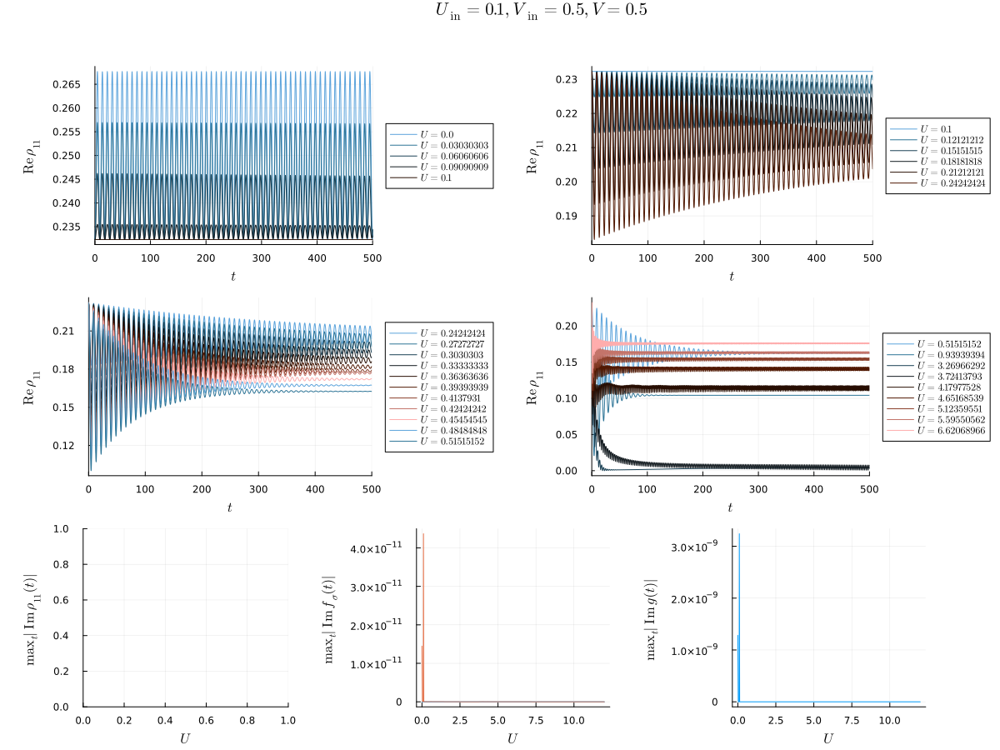

In [4]:
UList_Vin = sort(unique(df_Vin.U))
pa = plot(title=L"U_\mathrm{in}=%$Uin,V_\mathrm{in}=%$Vin,V=0.5", grid=false,showaxis=false,bottom_margn=-0mm)
p0 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, \rho_{11}",xlims=(0,500))
p1 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, \rho_{11}",xlims=(0,500))
p2 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, \rho_{11}",xlims=(0,500))
p3 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, \rho_{11}",xlims=(0,500))
p4 = plot(legend=nothing, xlabel=L"U", ylabel=L"\max_t | \mathrm{Im}\,\rho_{11} (t)|")
p5 = plot(legend=nothing, xlabel=L"U", ylabel=L"\max_t | \mathrm{Im}\,f_\sigma (t)|") 
p6 = plot(legend=nothing, xlabel=L"U", ylabel=L"\max_t | \mathrm{Im}\,g(t)|")
for Ui in UList_Vin[1:1:5]
    plot!(p0, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:rho11]), label=L"U=%$(round(Ui,digits=8))")
end

for Ui in UList_Vin[5:10]
    plot!(p1, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:rho11]), label=L"U=%$(round(Ui,digits=8))")
end
for Ui in UList_Vin[10:20]
    plot!(p2, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:rho11]), label=L"U=%$(round(Ui,digits=8))")
end
for Ui in UList_Vin[20:15:end]
    plot!(p3, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:rho11]), label=L"U=%$(round(Ui,digits=8))")
end

plot!(p5, df_Vin.U, map(x -> maximum(abs.(imag(x))), df_Vin[:,:rho11]))
plot!(p5, df_Vin.U, map(x -> maximum(abs.(imag(x))), df_Vin[:,:f_up]))
plot!(p6, df_Vin.U, map(x -> maximum(abs.(imag(x))), df_Vin[:,:C01]))

l = @layout [
    tt{1.0w, 0.001h}
    a{0.5w} b{0.5w} 
    c{0.5w} d{0.5w} 
    e{0.3w} f{0.3w}  g{0.3w}
    ]
plot(pa, p0, p1, p2, p3, p4, p5, p6, layout=l, size=(1200,900), left_margin=10mm)

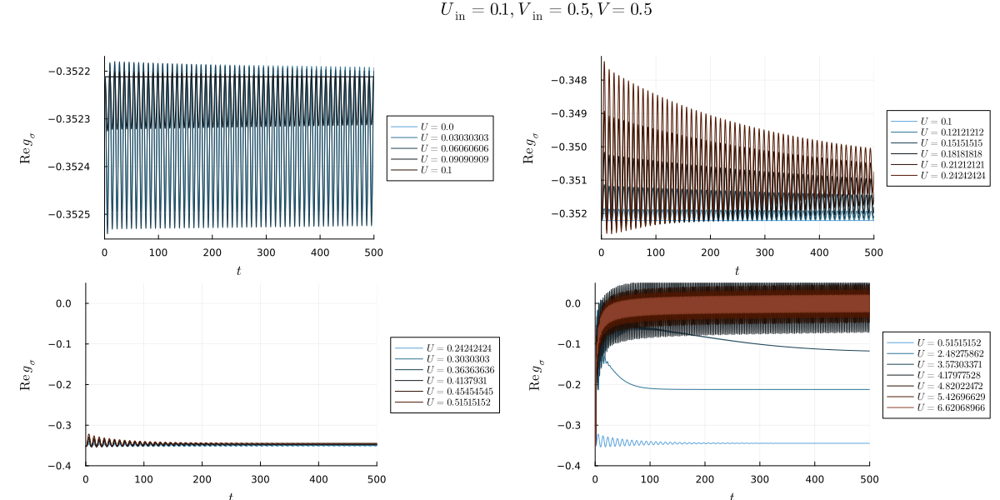

In [5]:
UList_Vin = sort(unique(df_Vin.U))
pa = plot(title=L"U_\mathrm{in}=%$Uin,V_\mathrm{in}=%$Vin,V=0.5", grid=false,showaxis=false,bottom_margn=-0mm)
p0 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, g_\sigma",xlims=(0,500))
p1 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, g_\sigma",xlims=(0,500))
p2 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, g_\sigma",xlims=(0,500), ylims=(-0.4,0.05))
p3 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, g_\sigma",xlims=(0,500), ylims=(-0.4,0.05))
for Ui in UList_Vin[1:1:5]
    plot!(p0, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:C01]), label=L"U=%$(round(Ui,digits=8))")
end

for Ui in UList_Vin[5:10]
    plot!(p1, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:C01]), label=L"U=%$(round(Ui,digits=8))")
end
for Ui in UList_Vin[10:2:20]
    plot!(p2, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:C01]), label=L"U=%$(round(Ui,digits=8))")
end
for Ui in UList_Vin[20:20:end]
    plot!(p3, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:C01]), label=L"U=%$(round(Ui,digits=8))")
end

plot!(p5, df_Vin.U, map(x -> maximum(abs.(imag(x))), df_Vin[:,:rho11]))
plot!(p5, df_Vin.U, map(x -> maximum(abs.(imag(x))), df_Vin[:,:f_up]))
plot!(p6, df_Vin.U, map(x -> maximum(abs.(imag(x))), df_Vin[:,:C01]))

l = @layout [
    tt{1.0w, 0.001h}
    a{0.5w} b{0.5w} 
    c{0.5w} d{0.5w} 
    ]
plot(pa, p0, p1, p2, p3, layout=l, size=(1200,600), left_margin=10mm)

L"$U_\mathrm{C} = 3.6741573033707864$"

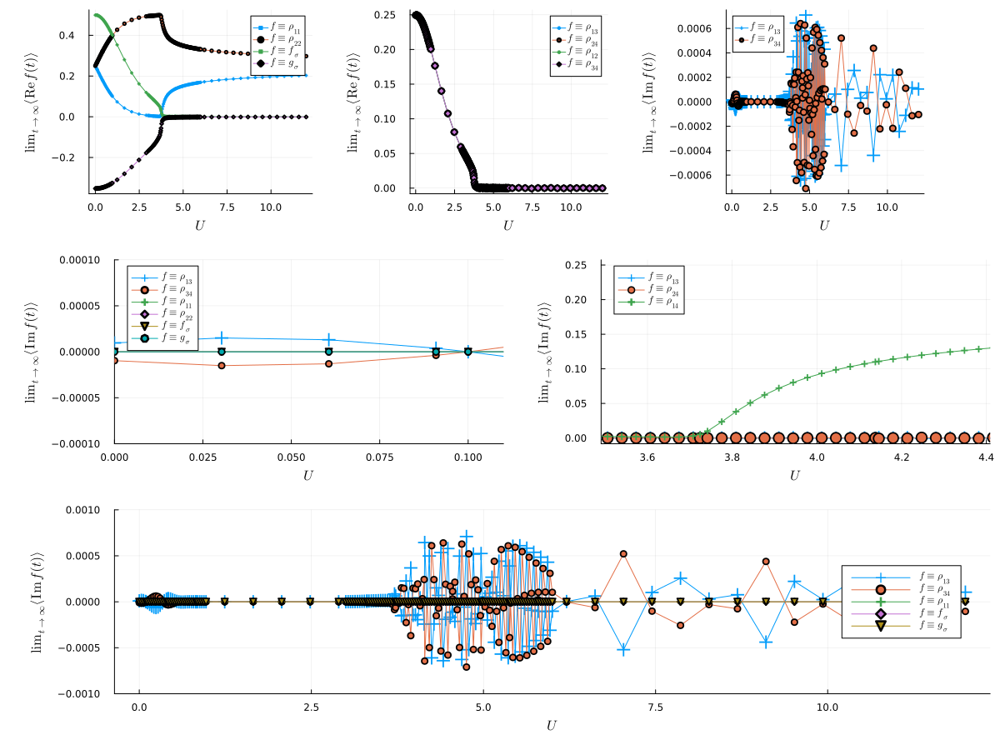

In [7]:
Ux = df_Vin.U
U_c_i = argmin(real(df_Vin.rho11_lim))
U_c = Ux[U_c_i]
U_in_i = findfirst(x->x≈Uin,Ux)
display(L"U_\mathrm{C} = %$(U_c)")

#p0 = plot(legend=:outerright,palette=:berlin10, title=L"U_\mathrm{in}=0.1,V_\mathrm{in}=0.5,V=0.5", xlabel=L"t", ylabel=L"\Re \rho_{11}",xlims=(50,500))
#p1 = plot(legend=:outerright,palette=:berlin10, title=L"U_\mathrm{in}=0.1,V_\mathrm{in}=0.5,V=0.5", xlabel=L"t", ylabel=L"\Re \rho_{11}",xlims=(50,500))

                    
p2 = plot(Ux, real(df_Vin.rho11_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty} \langle \mathrm{Re}\, f(t) \rangle",legend=:topright, markershape=:auto, label=L"f \equiv \rho_{11}", markersize=2)
plot!(Ux, real(df_Vin.rho22_lim), label=L"f \equiv \rho_{22}",  markershape=:auto, markersize=2)
plot!(Ux, real(df_Vin.f_up_lim), label=L"f \equiv f_{\sigma}",  markershape=:auto, markersize=2)
plot!(Ux, real(df_Vin.C01_lim), label=L"f \equiv g_{\sigma}",  markershape=:auto, markersize=2)
p3 = plot(Ux, real(df_Vin.rho13_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty}  \langle \mathrm{Re}\,f(t)\rangle",legend=:topright, markershape=:auto, label=L"f \equiv \rho_{13}")
plot!(Ux, real(df_Vin.rho24_lim), label=L"f \equiv \rho_{24}",  markershape=:auto)
plot!(Ux, real(df_Vin.rho12_lim), label=L"f \equiv \rho_{12}",  markershape=:auto)
plot!(Ux, real(df_Vin.rho34_lim), label=L"f \equiv \rho_{34}",  markershape=:auto)
p4 = plot(Ux, imag(df_Vin.rho13_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty} \langle \mathrm{Im}\, f(t)\rangle",legend=:topleft, markershape=:auto, label=L"f \equiv \rho_{13}", markersize=8)
#plot!(Ux, imag(df_Vin.rho24_lim), label=L"f \equiv \rho_{24}",  markershape=:auto, markersize=7)
#plot!(Ux, imag(df_Vin.rho12_lim), label=L"f \equiv \rho_{12}",  markershape=:auto)
plot!(Ux, imag(df_Vin.rho34_lim), label=L"f \equiv \rho_{34}",  markershape=:auto)

p5 = plot(Ux, imag(df_Vin.rho13_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty} \langle \mathrm{Im}\, f(t)\rangle",legend=:topleft, markershape=:auto, label=L"f \equiv \rho_{13}", markersize=8, xlims=(0.0,0.11), ylims=(-1e-4,1e-4))
#plot!(Ux, imag(df_Vin.rho24_lim), label=L"f \equiv \rho_{24}",  markershape=:auto, markersize=7)
#plot!(Ux, imag(df_Vin.rho12_lim), label=L"f \equiv \rho_{12}",  markershape=:auto)
plot!(Ux, imag(df_Vin.rho34_lim), label=L"f \equiv \rho_{34}",  markershape=:auto)
plot!(Ux, imag(df_Vin.rho11_lim), label=L"f \equiv \rho_{11}", markershape=:auto)
plot!(Ux, imag(df_Vin.rho22_lim), label=L"f \equiv \rho_{22}",  markershape=:auto)
plot!(Ux, imag(df_Vin.f_up_lim), label=L"f \equiv f_{\sigma}",  markershape=:auto)
plot!(Ux, imag(df_Vin.C01_lim), label=L"f \equiv g_{\sigma}",  markershape=:auto)

p6 = plot(Ux, imag(df_Vin.rho13_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty} \langle \mathrm{Im}\, f(t)\rangle",legend=:topleft, markershape=:auto, label=L"f \equiv \rho_{13}", markersize=8, xlims=(U_c - U_c/20, U_c + U_c/5))
plot!(Ux, imag(df_Vin.rho24_lim), label=L"f \equiv \rho_{24}",  markershape=:auto, markersize=7)
# eq 13: plot!(Ux, imag(df_Vin.rho12_lim), label=L"f \equiv \rho_{12}",  markershape=:auto) 
plot!(Ux, real(df_Vin.rho14_lim), label=L"f \equiv \rho_{14}",  markershape=:auto) 
# eq 24: plot!(Ux, imag(df_Vin.rho34_lim), label=L"f \equiv \rho_{34}",  markershape=:auto)

p7 = plot(Ux, imag(df_Vin.rho13_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty} \langle \mathrm{Im}\, f(t)\rangle",legend=:right, markershape=:auto, label=L"f \equiv \rho_{13}", markersize=8, ylims=(-1e-3,1e-3))
#plot!(Ux, imag(df_Vin.rho24_lim), label=L"f \equiv \rho_{24}",  markershape=:auto, markersize=7)
#plot!(Ux, imag(df_Vin.rho12_lim), label=L"f \equiv \rho_{12}",  markershape=:auto)
plot!(Ux, imag(df_Vin.rho34_lim), label=L"f \equiv \rho_{34}",  markershape=:auto)
plot!(Ux, imag(df_Vin.rho11_lim), label=L"f \equiv \rho_{11}", markershape=:auto)
#plot!(Ux, imag(df_Vin.rho22_lim), label=L"f \equiv \rho_{22}",  markershape=:auto)
plot!(Ux, imag(df_Vin.f_up_lim), label=L"f \equiv f_{\sigma}",  markershape=:auto)
plot!(Ux, imag(df_Vin.C01_lim), label=L"f \equiv g_{\sigma}",  markershape=:auto)

l = @layout [
        a{0.3w} b{0.3w}  c{0.3w}
        c{0.5w} d{0.5w} 
        e{1.0w}
    ]
p = plot(p2,p3,p4,p5,p6,p7, size=(1200,900), layout=l, left_margin=10mm, bottom_margin=5mm)
savefig("U_scale.pdf")
display(p)

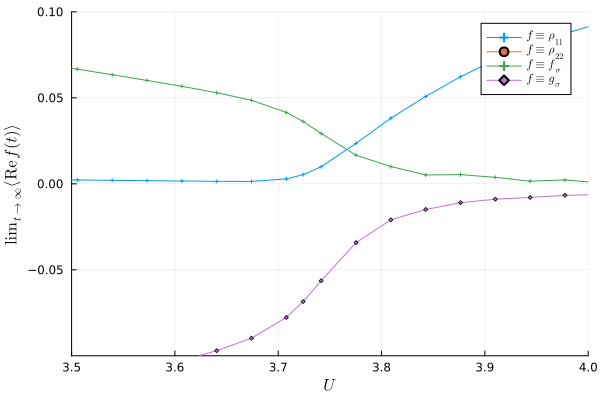

In [44]:
p2 = plot(Ux, real(df_Vin.rho11_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty} \langle \mathrm{Re}\, f(t) \rangle",legend=:topright, markershape=:auto, label=L"f \equiv \rho_{11}", markersize=2, xlims=(3.5,4.0), ylims=(-0.1,0.1))
plot!(Ux, real(df_Vin.rho22_lim), label=L"f \equiv \rho_{22}",  markershape=:auto, markersize=2)
plot!(Ux, real(df_Vin.f_up_lim), label=L"f \equiv f_{\sigma}",  markershape=:auto, markersize=2)
plot!(Ux, real(df_Vin.C01_lim), label=L"f \equiv g_{\sigma}",  markershape=:auto, markersize=2)

In [84]:
Ux[60:70]

11-element Vector{Float64}:
 3.573033707865168
 3.6067415730337076
 3.640449438202247
 3.6741573033707864
 3.7078651685393256
 3.724137931034483
 3.7415730337078656
 3.775280898876405
 3.8089887640449436
 3.842696629213483
 3.8764044943820224

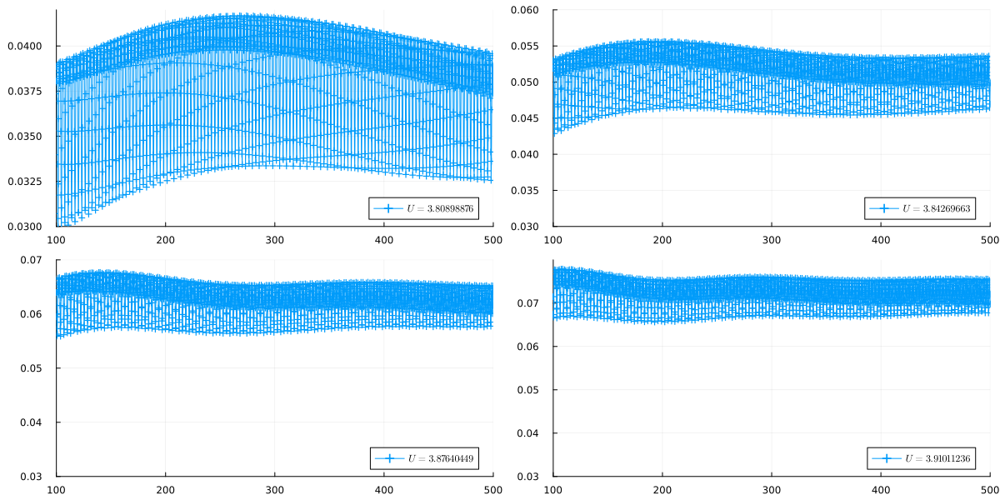

In [94]:
Ui = 68
p1 = plot(df_Vin[df_Vin.U .≈ Ux[Ui],:t], real(df_Vin[df_Vin.U .≈ Ux[Ui],:rho11]),  ylims=(0.03,0.042), xlims=(100,500), label=L"U=%$(round(Ux[Ui],digits=8))",markershape=:auto)
Ui = 69
p2 = plot(df_Vin[df_Vin.U .≈ Ux[Ui],:t], real(df_Vin[df_Vin.U .≈ Ux[Ui],:rho11]),  ylims=(0.03,0.06), xlims=(100,500), label=L"U=%$(round(Ux[Ui],digits=8))",markershape=:auto)

Ui = 70
p3 = plot(df_Vin[df_Vin.U .≈ Ux[Ui],:t], real(df_Vin[df_Vin.U .≈ Ux[Ui],:rho11]), ylims=(0.03,0.07), xlims=(100,500), label=L"U=%$(round(Ux[Ui],digits=8))",markershape=:auto)

Ui = 71
p4 = plot(df_Vin[df_Vin.U .≈ Ux[Ui],:t], real(df_Vin[df_Vin.U .≈ Ux[Ui],:rho11]), ylims=(0.03,0.08), xlims=(100,500), label=L"U=%$(round(Ux[Ui],digits=8))",markershape=:auto)
plot(p1,p2,p3,p4, size=(1200,600))

In [68]:
df_Vin[df_Vin.U .≈ Ux[80],:t]

1-element Vector{Vector{Float64}}:
 [0.0, 0.2501250625312656, 0.5002501250625312, 0.7503751875937968, 1.0005002501250624, 1.250625312656328, 1.5007503751875937, 1.7508754377188596, 2.0010005002501248, 2.2511255627813904  …  497.7488744372186, 497.99899949974986, 498.24912456228117, 498.4992496248124, 498.7493746873437, 498.99949974987493, 499.2496248124062, 499.49974987493744, 499.74987493746875, 500.0]

## Fourier Analysis

Extract:
- Frequencies omega_i, number of frequencies
- Amplitude A(t) (power spectrum?)
- phase phi_i

In [8]:
using FourierAnalysis
Upt = 2.6
Up, ii= findmin(abs.(df_Vin.U .- Upt))
freq_cut = 1.5

r11_i = (df_Vin[ii,:rho11])
rho11_lim = (df_Vin[ii,:rho11_lim])
r12_i = (df_Vin[ii,:rho12])
rho12_lim = (df_Vin[ii,:rho12_lim])
fs_i = (df_Vin[ii,:f_up])
f_lim = (df_Vin[ii,:f_up_lim])
gs_i = (df_Vin[ii,:C01])
g_lim = (df_Vin[ii,:C01_lim])
tx = df_Vin[ii,:t]
U_i = df_Vin[ii, :U]

slice = 1:length(r11_i)
tx_fft = tx[slice]
r11_fft = FourierAnalysis.fft(r11_i[slice] .- rho11_lim)[1:end] ./ length(slice)  |> FourierAnalysis.fftshift
r12_fft = FourierAnalysis.fft(r12_i[slice] .- rho12_lim)[1:end] ./ length(slice)  |> FourierAnalysis.fftshift
r11_fft_full = FourierAnalysis.fft(r11_i[slice])[1:end] ./ length(slice)  |> FourierAnalysis.fftshift
freqs = FourierAnalysis.fftfreq(length(tx_fft), 1.0/diff(tx_fft)[1]) |> FourierAnalysis.fftshift


fs_fft = FourierAnalysis.fft(fs_i[slice] .- f_lim)[1:end] ./ length(slice)  |> FourierAnalysis.fftshift
gs_fft = FourierAnalysis.fft(gs_i[slice] .- g_lim)[1:end] ./ length(slice)  |> FourierAnalysis.fftshift


freqs = FourierAnalysis.fftfreq(length(tx_fft), 1.0/diff(tx_fft)[1]) |> FourierAnalysis.fftshift
spectrums_rho11_zm = log.(abs.(hcat(df_Vin.rho11_fft_zm...)))
spectrums_rho12_zm = log.(abs.(hcat(df_Vin.rho12_fft_zm...)))
spectrums_f_zm = log.(abs.(hcat(df_Vin.f_up_fft_zm...)))
spectrums_g_zm = log.(abs.(hcat(df_Vin.C01_fft_zm...)))
spectrums_rho11 = log.(abs.(hcat(df_Vin.rho11_fft...)))
spectrums_rho12 = log.(abs.(hcat(df_Vin.rho12_fft...)))
spectrums_f = log.(abs.(hcat(df_Vin.f_up_fft...)))
spectrums_g = log.(abs.(hcat(df_Vin.C01_fft...)));

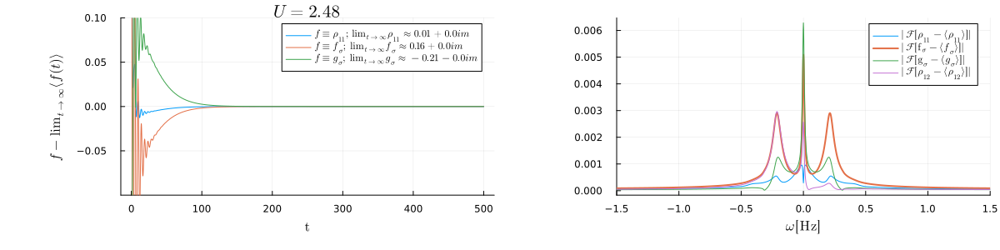

In [9]:
p1 = plot(tx, real(r11_i .- rho11_lim), ylims=(-0.1,0.1),
        title=L"U=%$(round(U_i,digits=2))", xlabel=L"\mathrm{t}", ylabel=L"f - \lim_{t \to \infty} \langle f(t) \rangle", label=L"f \equiv \rho_{11};\, \lim_{t\to\infty} \rho_{11}  \approx %$(round(rho11_lim,digits=2))")
#vline!([tx[first(slice)]], color=:orange, label="FT start")
plot!(tx, real(fs_i .- f_lim), label=L"f \equiv f_\sigma;\; \lim_{t\to\infty} f_\sigma \approx %$(round(f_lim,digits=2))")
plot!(tx, real(gs_i .- g_lim), label=L"f \equiv g_\sigma;\; \lim_{t\to\infty} g_\sigma \approx %$(round(g_lim,digits=2))")
p2 = plot(freqs, abs.(r11_fft), xlabel=L"\omega [\mathrm{Hz}]", label=L" | \mathcal{F}[\mathrm{\rho_{11}} - \langle \rho_{11} \rangle] |", xlims=(-freq_cut,freq_cut))
plot!(freqs, abs.(fs_fft), label=L"| \mathcal{F}[\mathrm{f_\sigma} - \langle f_\sigma \rangle] |", xlims=(-freq_cut,freq_cut), lw=2)
plot!(freqs, abs.(gs_fft), label=L"| \mathcal{F}[\mathrm{g_\sigma}  - \langle g_\sigma \rangle] |", xlims=(-freq_cut,freq_cut))
plot!(freqs, abs.(r12_fft), label=L"|\mathcal{F}[\mathrm{\rho_{12}} - \langle \rho_{12} \rangle]  |", xlims=(-freq_cut,freq_cut))

l = @layout [
    a{0.5w} b{0.5w}
    ]
p = plot(p1, p2,  layout=l,size=(1200,300), left_margin=20mm, bottom_margin=10mm)
display(p)

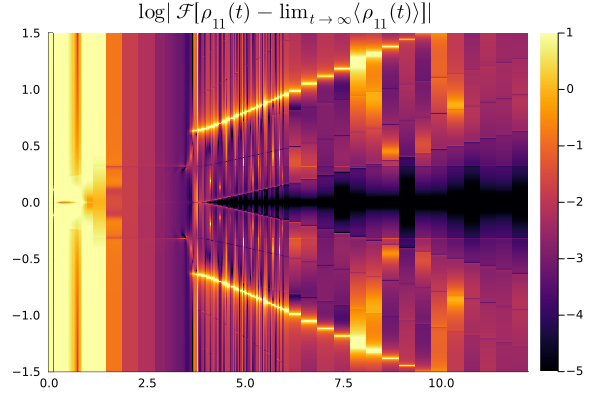

In [54]:

    p7 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho11 .- spectrums_g,clims=(-5,1), ylims=(-freq_cut,freq_cut),       title=L"\log \,|\mathcal{F}[\rho_{11}(t) - \lim_{t \to \infty} \langle \rho_{11}(t) \rangle]|")

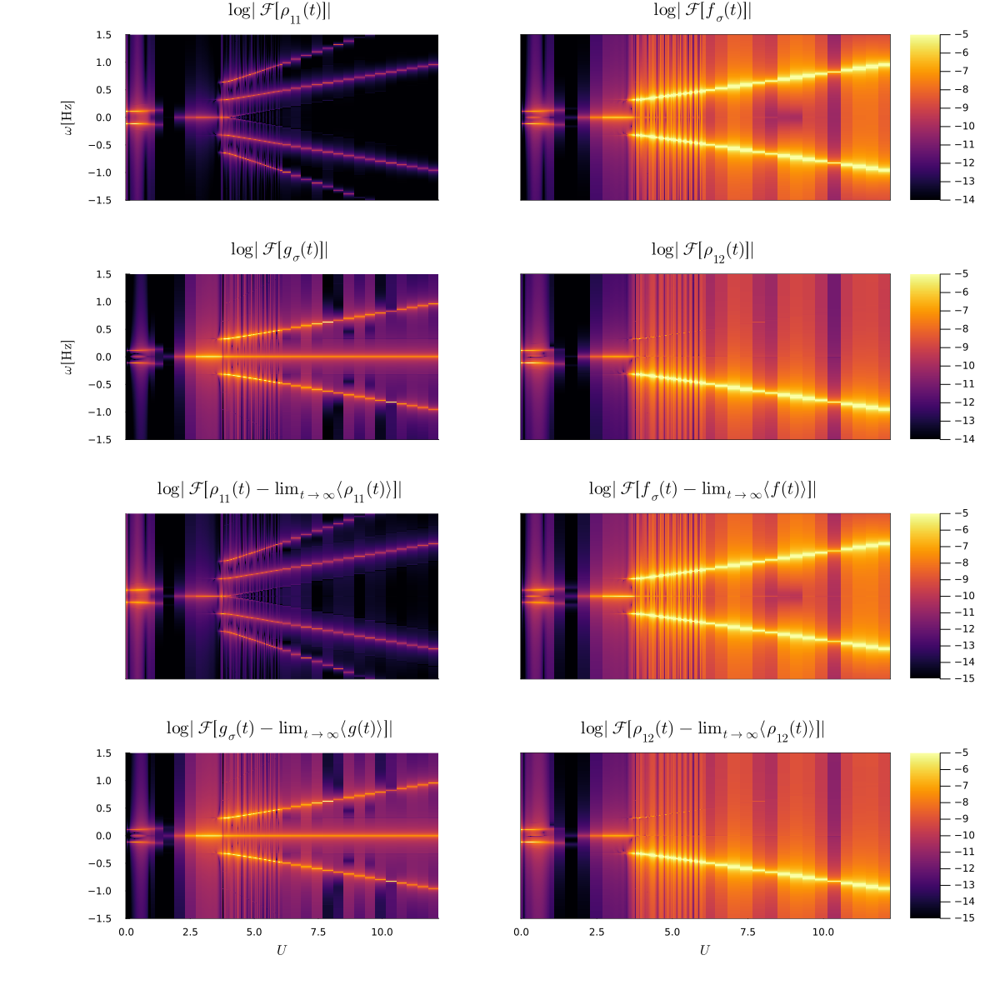

In [10]:
p3 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho11_zm,clims=(-14,-5), ylims=(-freq_cut,freq_cut), ylabel=L"\omega [\mathrm{Hz}]", title=L"\log \,|\mathcal{F}[\rho_{11}(t)]|",legend=nothing, xticks=nothing, bottom_margin=-5mm, right_margin=-5mm)
p4 = heatmap(Ux,df_Vin[1,:freqs],spectrums_f_zm,clims=(-14,-5), ylims=(-freq_cut,freq_cut),  title=L"\log \,|\mathcal{F}[f_\sigma(t)]|", framestyle=:box, xticks=nothing, yticks=nothing)
p5 = heatmap(Ux,df_Vin[1,:freqs],spectrums_g_zm,clims=(-14,-5), ylims=(-freq_cut,freq_cut), ylabel=L"\omega [\mathrm{Hz}]", title=L"\log \,|\mathcal{F}[g_\sigma(t)]|",legend=nothing, xticks=nothing)
p6 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho12_zm,clims=(-14,-5), ylims=(-freq_cut,freq_cut),   title=L"\log \,|\mathcal{F}[\rho_{12}(t)]|", framestyle=:box, xticks=nothing, yticks=nothing)
p7 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho11,clims=(-15,-5), ylims=(-freq_cut,freq_cut),       title=L"\log \,|\mathcal{F}[\rho_{11}(t) - \lim_{t \to \infty} \langle \rho_{11}(t) \rangle]|",legend=nothing, xticks=nothing, yticks=nothing)
p8 = heatmap(Ux,df_Vin[1,:freqs],spectrums_f,clims=(-15,-5), ylims=(-freq_cut,freq_cut),         title=L"\log \,|\mathcal{F}[f_\sigma(t) - \lim_{t \to \infty} \langle f(t) \rangle]|", framestyle=:box, xticks=nothing, yticks=nothing)
p9 = heatmap(Ux,df_Vin[1,:freqs],spectrums_g,clims=(-15,-5), ylims=(-freq_cut,freq_cut), xlabel=L"U",  title=L"\log \,|\mathcal{F}[g_\sigma(t) - \lim_{t \to \infty} \langle g(t) \rangle]|",legend=nothing)
p10 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho12,clims=(-15,-5), ylims=(-freq_cut,freq_cut), xlabel=L"U",  title=L"\log \,|\mathcal{F}[\rho_{12}(t) - \lim_{t \to \infty} \langle \rho_{12}(t) \rangle]|", framestyle=:box, yticks=nothing)

l = @layout [
    c{0.4w} d{0.6w} 
    e{0.4w} f{0.6w} 
    g{0.4w} h{0.6w}
    l{0.4w} j{0.6w}
    ]
p = plot( p3, p4, p5, p6, p7, p8, p9, p10, layout=l,size=(1200,1200), left_margin=20mm, bottom_margin=10mm)
savefig("fourier.pdf")
display(p)

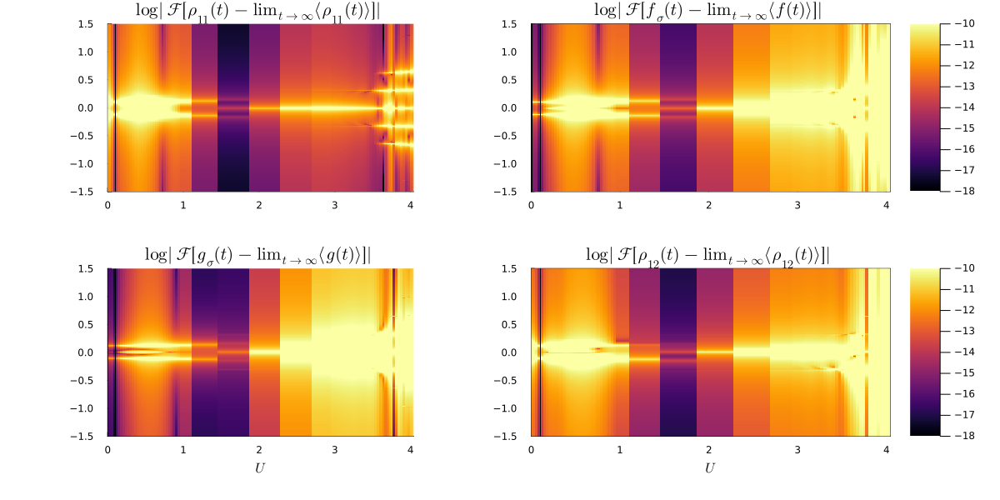

In [50]:
p7 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho11,clims=(-18,-10), ylims=(-freq_cut,freq_cut), xlims=(0,1.1*U_c), title=L"\log \,|\mathcal{F}[\rho_{11}(t) - \lim_{t \to \infty} \langle \rho_{11}(t) \rangle]|",legend=nothing,)
p8 = heatmap(Ux,df_Vin[1,:freqs],spectrums_f,clims=(-18,-10), ylims=(-freq_cut,freq_cut), xlims=(0,1.1*U_c),         title=L"\log \,|\mathcal{F}[f_\sigma(t) - \lim_{t \to \infty} \langle f(t) \rangle]|", framestyle=:box,)
p9 = heatmap(Ux,df_Vin[1,:freqs],spectrums_g,clims=(-18,-10), ylims=(-freq_cut,freq_cut), xlims=(0,1.1*U_c), xlabel=L"U",  title=L"\log \,|\mathcal{F}[g_\sigma(t) - \lim_{t \to \infty} \langle g(t) \rangle]|",legend=nothing)
p10 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho12,clims=(-18,-10), ylims=(-freq_cut,freq_cut), xlims=(0,1.1*U_c), xlabel=L"U",  title=L"\log \,|\mathcal{F}[\rho_{12}(t) - \lim_{t \to \infty} \langle \rho_{12}(t) \rangle]|", framestyle=:box)

l = @layout [ 
    g{0.4w} h{0.6w}
    l{0.4w} j{0.6w}
    ]
p = plot(p7, p8, p9, p10, layout=l,size=(1200,600), left_margin=20mm, bottom_margin=10mm)
display(p)

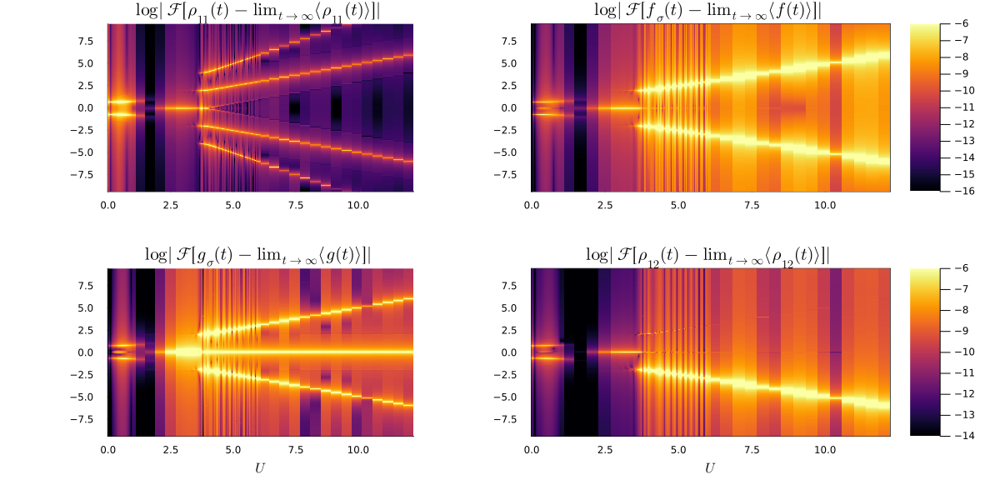

In [12]:
p7 = heatmap(Ux,2π .* df_Vin[1,:freqs],spectrums_rho11,clims=(-16,-8), ylims=2π .*(-freq_cut,freq_cut),       title=L"\log \,|\mathcal{F}[\rho_{11}(t) - \lim_{t \to \infty} \langle \rho_{11}(t) \rangle]|",legend=nothing,)
p8 = heatmap(Ux,2π .* df_Vin[1,:freqs],spectrums_f,clims=(-16,-6), ylims=2π .*(-freq_cut,freq_cut),         title=L"\log \,|\mathcal{F}[f_\sigma(t) - \lim_{t \to \infty} \langle f(t) \rangle]|", framestyle=:box,)
p9 = heatmap(Ux,2π .* df_Vin[1,:freqs],spectrums_g,clims=(-16,-8), ylims=2π .*(-freq_cut,freq_cut), xlabel=L"U",  title=L"\log \,|\mathcal{F}[g_\sigma(t) - \lim_{t \to \infty} \langle g(t) \rangle]|",legend=nothing)
p10 = heatmap(Ux,2π .* df_Vin[1,:freqs],spectrums_rho12,clims=(-14,-6), ylims=2π .*(-freq_cut,freq_cut), xlabel=L"U",  title=L"\log \,|\mathcal{F}[\rho_{12}(t) - \lim_{t \to \infty} \langle \rho_{12}(t) \rangle]|", framestyle=:box)

l = @layout [ 
    g{0.4w} h{0.6w}
    l{0.4w} j{0.6w}
    ]
p = plot(p7, p8, p9, p10, layout=l,size=(1200,600), left_margin=20mm, bottom_margin=10mm)
display(p)

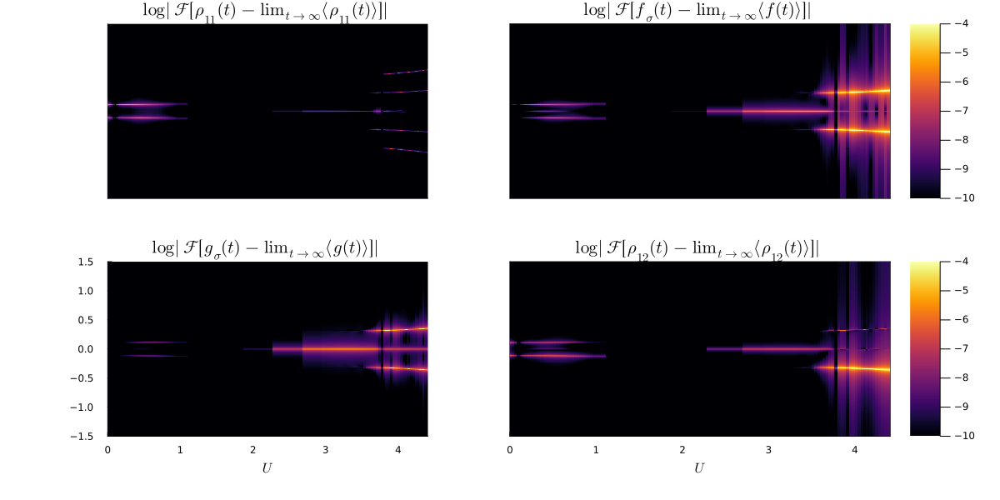

In [13]:
p7 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho11,clims=(-10,-4), ylims=(-freq_cut,freq_cut), xlims=(0,1.2 * U_c),       title=L"\log \,|\mathcal{F}[\rho_{11}(t) - \lim_{t \to \infty} \langle \rho_{11}(t) \rangle]|",legend=nothing, xticks=nothing, yticks=nothing)
p8 = heatmap(Ux,df_Vin[1,:freqs],spectrums_f,clims=(-10,-4), ylims=(-freq_cut,freq_cut), xlims=(0,1.2 * U_c),         title=L"\log \,|\mathcal{F}[f_\sigma(t) - \lim_{t \to \infty} \langle f(t) \rangle]|", framestyle=:box, xticks=nothing, yticks=nothing)
p9 = heatmap(Ux,df_Vin[1,:freqs],spectrums_g,clims=(-10,-4), ylims=(-freq_cut,freq_cut), xlims=(0,1.2 * U_c), xlabel=L"U",  title=L"\log \,|\mathcal{F}[g_\sigma(t) - \lim_{t \to \infty} \langle g(t) \rangle]|",legend=nothing)
p10 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho12,clims=(-10,-4), ylims=(-freq_cut,freq_cut), xlims=(0,1.2 * U_c), xlabel=L"U",  title=L"\log \,|\mathcal{F}[\rho_{12}(t) - \lim_{t \to \infty} \langle \rho_{12}(t) \rangle]|", framestyle=:box, yticks=nothing)

l = @layout [
    g{0.4w} h{0.6w}
    l{0.4w} j{0.6w}
    ]
p = plot(  p7, p8, p9, p10, layout=l,size=(1200,600), left_margin=20mm, bottom_margin=10mm)
#savefig("fourier2.pdf")
display(p)

In [15]:
Uin

0.1

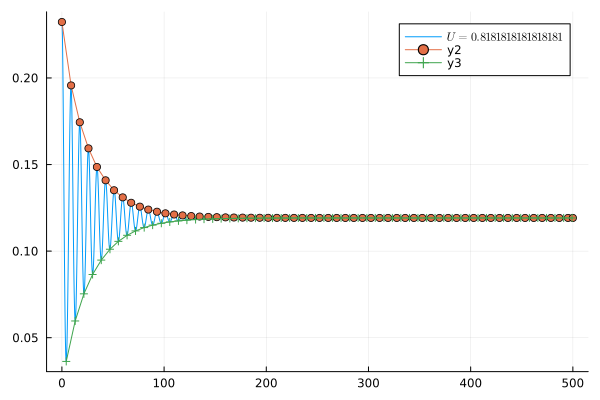

In [49]:
#y=analyticsignal(r11_0)
using Images
Ui = 30
r11_0 = real(df_Vin[df_Vin.U .≈ Ux[Ui], :rho11][1])
maxy_ix = findlocalmaxima(r11_0)
miny_ix = findlocalminima(r11_0)
plot(tx, r11_0, label=L"U=%$(Ux[Ui])")
plot!(tx[maxy_ix],r11_0[maxy_ix],markershape=:auto)
plot!(tx[miny_ix],r11_0[miny_ix],markershape=:auto)

In [17]:
r11_0

2000-element Vector{Float64}:
 0.2322995282445528
 0.22355731734085724
 0.19912557895187794
 0.16415579160837068
 0.12624861915366967
 0.09359868251428861
 0.07248543989651221
 0.06514847138715692
 0.06925419254494487
 0.07940278854899951
 0.08990131990942932
 0.09725767232301862
 0.10104227172329602
 ⋮
 0.003502597311746235
 0.0035026767550328706
 0.0035026402679033983
 0.003502510101928787
 0.0035023312532289214
 0.003502160351264831
 0.0035020517537540864
 0.0035020442614495722
 0.00350215170054166
 0.003502359658976912
 0.0035026291467797864
 0.0035029062510398487

# std? of time plot
# lim of amplitude plot (extrapolate!!!!)

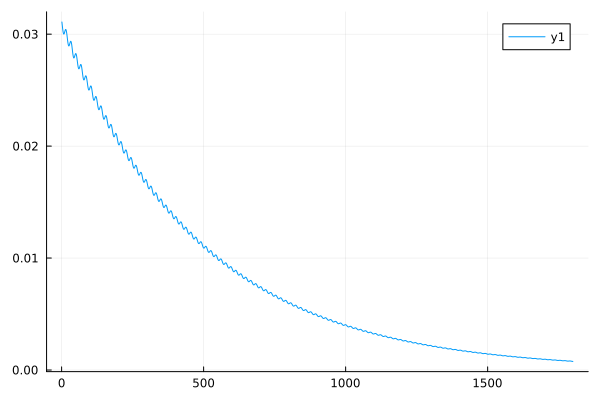

In [23]:
plot(df_Vin.rho11_std[12])

# Amplitude (contradiction to paper)

# Effects of V

- V -> oo : higher frequency
- V > V_C : more than one frequency

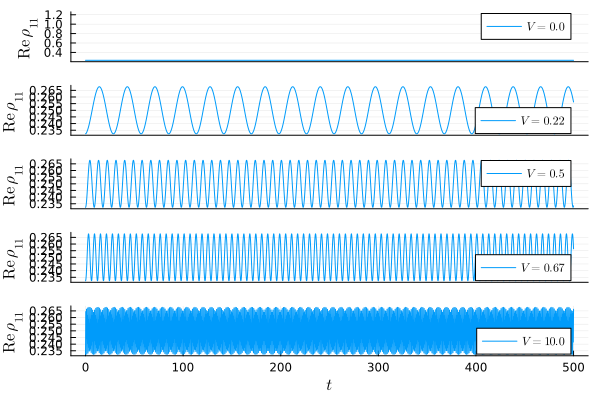

In [24]:
tt = df[df.U .≈ 0.0 .&& df.V .≈ 0.0,:]
p1 = plot(tt.t, real(tt.rho11), xaxis=nothing, ylabel=L"\mathrm{Re}\,\rho_{11}", label=L"V=%$0.0")
tt = df[df.U .≈ 0.0 .&& df.V .≈ VList[2],:]
p2 = plot(tt.t, real(tt.rho11), xaxis=nothing, ylabel=L"\mathrm{Re}\,\rho_{11}", label=L"V=%$(round(VList[2],digits=2))")
tt = df[df.U .≈ 0.0 .&& df.V .≈ 0.5,:]
p3 = plot(tt.t, real(tt.rho11), xaxis=nothing, ylabel=L"\mathrm{Re}\,\rho_{11}", label=L"V=%$(round(0.5,digits=2))")
tt = df[df.U .≈ 0.0 .&& df.V .≈ VList[6],:]
p4 = plot(tt.t, real(tt.rho11), xaxis=nothing, ylabel=L"\mathrm{Re}\,\rho_{11}", label=L"V=%$(round(VList[6],digits=2))")
tt = df[df.U .≈ 0.0 .&& df.V .≈ VList[end],:]
p5 = plot(tt.t, real(tt.rho11), xlabel=L"t", ylabel=L"\mathrm{Re}\,\rho_{11}", label=L"V=%$(round(VList[end],digits=2))")

plot(p1,p2,p3,p4,p5, layout=(5,1))